# Heart Stroke Prediction 

# Introduction

Stroke is the second leading Cause of death worldwide which remains very important factor for national healthcare systems as well as individuals, majorly for elderly population. World health Organisation (WHO) has estimated around 12 million deaths worldwide every year due to heart disease. An estimated 18 million people died from cardiovascular diseases in 2019, which representing 32% of all global deaths. Of all these deaths, 85% were due to heart strokes.

Every 4 minutes someone dies of heart stroke, but 80% of stroke can be prevented if we identify or predict the occurrence of stroke in its early stage.

So, it’s very important to detect cardiovascular disease as early as possible, so that hospital managements can start doing research and medicines can begin.

Early prognosis of heart stroke can help in making decisions on lifestyle changes in high-risk patients and thereby reducing further complication in future.

Therefore, goal of our project is to apply different machine learning and deep learning models over large existing data sets to effectively predict the stroke based on high risk factors involved.





# Problem Definition and Understanding

For this project, the task is to predict the stroke using a variety of distinct features or independent variables.  This process entails the application and comparison of various ML algorithms & DL algorithm to identify the most effective algorithm to predict the heart stroke.

# Data Collection

The dataset used for this research project for predicting heart stroke was obtained from Kaggle comprising 43400 patient observations and 12 attributes. 

# Importing Necessary Libraries

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

import plotly.express as px
%matplotlib inline



from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder

from sklearn.model_selection import RandomizedSearchCV,StratifiedKFold
from scipy.stats import randint

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

!pip install imbalanced-learn==0.6.0
from sklearn.metrics import (confusion_matrix ,
                             accuracy_score,
                             classification_report, 
                             precision_score, 
                             recall_score,
                             roc_auc_score,
                               roc_curve)
import warnings
warnings.filterwarnings('ignore')





In [3]:
stroke_df= pd.read_csv("stroke dataset.csv")

In [4]:
stroke_df.head()

,ID,Gender,Age,Hypertension,Heart_Disease,Ever_Married,Work_Type,Residence_Type,Avg_Glucose_Level,BMI,Smoking_Status,Stroke
0,30669,Male,3.0,0,0,No,children,Rural,95.12,18.0,NaN,0
1,30468,Male,58.0,1,0,Yes,Private,Urban,87.96,39.2,never smoked,0
2,16523,Female,8.0,0,0,No,Private,Urban,110.89,17.6,NaN,0
3,56543,Female,70.0,0,0,Yes,Private,Rural,69.04,35.9,formerly smoked,0
4,46136,Male,14.0,0,0,No,Never_worked,Rural,161.28,19.1,NaN,0


In [5]:
stroke_df.shape

(43400, 12)

Shape function gives the total number of rows and columns in the dataset.

In [6]:
stroke_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43400 entries, 0 to 43399
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   ID                 43400 non-null  int64  
 1   Gender             43400 non-null  object 
 2   Age                43400 non-null  float64
 3   Hypertension       43400 non-null  int64  
 4   Heart_Disease      43400 non-null  int64  
 5   Ever_Married       43400 non-null  object 
 6   Work_Type          43400 non-null  object 
 7   Residence_Type     43400 non-null  object 
 8   Avg_Glucose_Level  43400 non-null  float64
 9   BMI                41938 non-null  float64
 10  Smoking_Status     30108 non-null  object 
 11  Stroke             43400 non-null  int64  
dtypes: float64(3), int64(4), object(5)
memory usage: 4.0+ MB


# Data Cleaning

The initial step in preparing the data is the data cleaning procedure, a systematic process for resolving issues, inconsistencies, and errors within a dataset. Data cleaning enhances data integrity, ensuring accurate outcomes from model applications. Hence, in implementing this model, dedicated modules were created to handle all aspects of data cleaning systematically.
A pivotal part of this cleaning procedure involves checking and removing any instances of missing or null values.


In [7]:
stroke_df.isnull().sum()

ID                       0
Gender                   0
Age                      0
Hypertension             0
Heart_Disease            0
Ever_Married             0
Work_Type                0
Residence_Type           0
Avg_Glucose_Level        0
BMI                   1462
Smoking_Status       13292
Stroke                   0
dtype: int64

the dataset contains some missing values in BMI and smoking status. lets try to fill them first before moving forward.

# Imputing missing Values 

In [8]:
stroke_df.interpolate(inplace=True)

In [9]:
stroke_df.fillna(method='ffill',inplace=True)

Ffill function fills the missing value with last valid value which is before the null value in the dataset

In [10]:
stroke_df.isnull().sum()

ID                   0
Gender               0
Age                  0
Hypertension         0
Heart_Disease        0
Ever_Married         0
Work_Type            0
Residence_Type       0
Avg_Glucose_Level    0
BMI                  0
Smoking_Status       1
Stroke               0
dtype: int64

In [11]:
stroke_df.fillna(method='bfill',inplace=True)

bfill function fills the missing value with first valid value which is before the null value in the dataset

In [12]:
stroke_df.isnull().sum()

ID                   0
Gender               0
Age                  0
Hypertension         0
Heart_Disease        0
Ever_Married         0
Work_Type            0
Residence_Type       0
Avg_Glucose_Level    0
BMI                  0
Smoking_Status       0
Stroke               0
dtype: int64

In [13]:
stroke_df

,ID,Gender,Age,Hypertension,Heart_Disease,Ever_Married,Work_Type,Residence_Type,Avg_Glucose_Level,BMI,Smoking_Status,Stroke
0,30669,Male,3.0,0,0,No,children,Rural,95.12,18.0,never smoked,0
1,30468,Male,58.0,1,0,Yes,Private,Urban,87.96,39.2,never smoked,0
2,16523,Female,8.0,0,0,No,Private,Urban,110.89,17.6,never smoked,0
3,56543,Female,70.0,0,0,Yes,Private,Rural,69.04,35.9,formerly smoked,0
4,46136,Male,14.0,0,0,No,Never_worked,Rural,161.28,19.1,formerly smoked,0
...,...,...,...,...,...,...,...,...,...,...,...,...
43395,56196,Female,10.0,0,0,No,children,Urban,58.64,20.4,never smoked,0
43396,5450,Female,56.0,0,0,Yes,Govt_job,Urban,213.61,55.4,formerly smoked,0
43397,28375,Female,82.0,1,0,Yes,Private,Urban,91.94,28.9,formerly smoked,0
43398,27973,Male,40.0,0,0,Yes,Private,Urban,99.16,33.2,never smoked,0


In [14]:
stroke_df.drop(columns=['ID'],inplace=True)

In [15]:
stroke_df

,Gender,Age,Hypertension,Heart_Disease,Ever_Married,Work_Type,Residence_Type,Avg_Glucose_Level,BMI,Smoking_Status,Stroke
0,Male,3.0,0,0,No,children,Rural,95.12,18.0,never smoked,0
1,Male,58.0,1,0,Yes,Private,Urban,87.96,39.2,never smoked,0
2,Female,8.0,0,0,No,Private,Urban,110.89,17.6,never smoked,0
3,Female,70.0,0,0,Yes,Private,Rural,69.04,35.9,formerly smoked,0
4,Male,14.0,0,0,No,Never_worked,Rural,161.28,19.1,formerly smoked,0
...,...,...,...,...,...,...,...,...,...,...,...
43395,Female,10.0,0,0,No,children,Urban,58.64,20.4,never smoked,0
43396,Female,56.0,0,0,Yes,Govt_job,Urban,213.61,55.4,formerly smoked,0
43397,Female,82.0,1,0,Yes,Private,Urban,91.94,28.9,formerly smoked,0
43398,Male,40.0,0,0,Yes,Private,Urban,99.16,33.2,never smoked,0


In [16]:
stroke_df.describe()

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI,Stroke
count,43400.000000,43400.000000,43400.000000,43400.000000,43400.000000,43400.000000
mean,42.217894,0.093571,0.047512,104.482750,28.608874,0.018041
std,22.519649,0.291235,0.212733,43.111751,7.703519,0.133103
min,0.080000,0.000000,0.000000,55.000000,10.100000,0.000000
25%,24.000000,0.000000,0.000000,77.540000,23.300000,0.000000
50%,44.000000,0.000000,0.000000,91.580000,27.800000,0.000000
75%,60.000000,0.000000,0.000000,112.070000,32.800000,0.000000
max,82.000000,1.000000,1.000000,291.050000,97.600000,1.000000


describe() function tells us the min and max values of each feature along with mean and standard deviation value of each feature in the dataset. By this we can estimate the skewness and distribution of each feature.

In [17]:
y = stroke_df['Stroke']


In [18]:
print(f'Percentage of patient had a stroke: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)\nPercentage of patient did not have a stroke: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} patient)')

Percentage of patient had a stroke: % 1.8 --> (783 patient)
Percentage of patient did not have a stroke: % 98.2 --> (42617 patient)


# Exploratory data analysis(EDA)

In [19]:
sns.set_style('whitegrid')
matplotlib.rcParams['font.size'] = 12
matplotlib.rcParams['figure.figsize'] = (8,4)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [20]:
px.histogram(stroke_df,
            x='Stroke',
            title='Stroke Ratio',
           width=400, height=400 )

Clearly, the dataset is unbalanced in the favour of no stroke.
19 : 1 ratio is observed for No Stroke : Stroke!
Thus, due to such heavy bias towards cases of No Stroke, predictions cannot be trusted!


the problem is most of the machine learning algorithm do not work well with the imbalanced data

some of the metrics like accuracy give us misleading results

most of the time in binary classification probelms , our aim is to get predict better results on the minority class which is in our case is people had a stroke, otherwise our model fasely predict majority class-No Stroke 

In [27]:
px.histogram(stroke_df,
            x='Age',
            color= 'Stroke',
            width=400, height=400)

In [28]:
px.histogram(stroke_df,
            x='Hypertension',
            color= 'Stroke',
            width=400, height=400)

In [29]:
px.histogram(stroke_df,
            x='Gender',
            color= 'Stroke',
            width=400, height=400)

In [30]:
px.histogram(stroke_df,
            x='Heart_Disease',
            color= 'Stroke',
            width=400, height=400)

In [31]:
px.histogram(stroke_df,
            x='Ever_Married',
            color= 'Stroke',
            width=400, height=400)

In [32]:
px.histogram(stroke_df,
            x='Work_Type',
            color= 'Stroke',
            width=400, height=400)

In [34]:
px.histogram(stroke_df,
            x='Smoking_Status',
            color= 'Stroke',
            width=400, height=400)

# Observations

Female has more probability of getting stroke than male 

people with no hypertension have high probability of getting stroke than people with hypertension (may be due high data imbalance, has too many negative 0 variables in the dataset). Same goes to heart disease.

The people who got married has a probability of getting stroke is much higher than people who are unmarried.

Private employees seem to have higher probability of getting stroke than any other work types. next in the line is self-employed.


Surprisingly people who never smokes has a higher probability of getting stoke than who smokes (may due to other factors considering the sample size of people who never smokes and people who used to smoke and smoke now)


In [35]:
#correlation with target variable

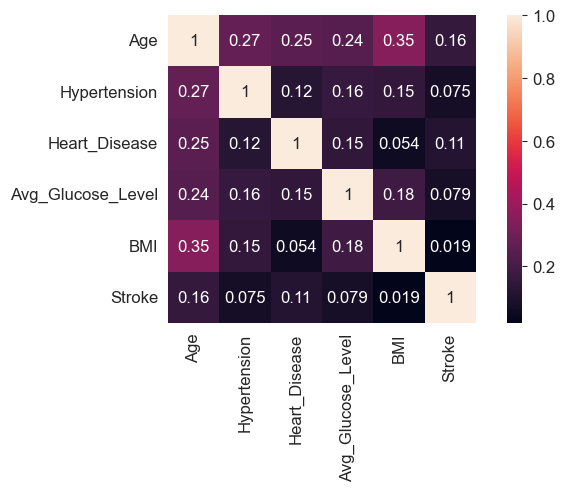

In [36]:
correlation =  stroke_df.corr()
plt.figure ( figsize = (8, 4))
sns.heatmap( correlation, annot = True, square=True)
plt.show()

In [37]:
px.scatter(stroke_df,
            x='Age',
            y='BMI',
            title='Age vs BMI',
            color= 'Stroke')

In [38]:
px.scatter(stroke_df,
            x='Age',
            y='Avg_Glucose_Level',
            color= 'Stroke')

In [39]:
px.scatter(stroke_df,
            x='BMI',
            y='Avg_Glucose_Level',
            color= 'Stroke')

# Observations

The data seems highly imbalanced (only few points showing the signs of stroke)

The Age group is heavily distributed between 0 to 60 with no stroke and only points showing the signs of stroke between the age group 60 -80 

Age and Avg Glucose levels can be split into 2 sperate clusters. one less than 150 and other more than 150. Age between 60-80 and Avg glucose levels between 0-150 showing the same level of stroke points with Avg glucose level between 150-250.

Individuals with BMIs and glucose levels below 150 have a lower risk of stroke than those with glucose levels over 150. Avg glucose levels are also low in people with BMIs over 40.


# spliting the dataset into training and test set

Before building any real-world machine learning models, it is a common method to split the 
data set into training set and test set. 
We train the model using the training set, we give inputs to our model which will be randomly 
initialized with some weights, then we take outputs from that model and compare with actual 
targets and compute the loss using loss function. 
We will not use the training set to predict new data, it will not be accurate. for this reason, we 
use test set. 
The test set- it’s a fraction of the dataset which is not to train the model but to evaluate the 
model to see how well the model is performing. 

In [44]:
train_set, test_set= train_test_split(stroke_df, test_size=0.2 , random_state=42)

In [45]:
train_set.shape

(34720, 11)

In [46]:
test_set.shape

(8680, 11)

# identifying input and target columns


 we separate our target column ‘Stroke’, from the input column. We don’t use 
the target column as an input column because we compare input columns with target column 
to see how well our model is performing. 

In [47]:
stroke_df.columns

Index(['Gender', 'Age', 'Hypertension', 'Heart_Disease', 'Ever_Married',
       'Work_Type', 'Residence_Type', 'Avg_Glucose_Level', 'BMI',
       'Smoking_Status', 'Stroke'],
      dtype='object')

In [48]:
input_columns= (stroke_df.columns)[0:10]

In [49]:
input_columns

Index(['Gender', 'Age', 'Hypertension', 'Heart_Disease', 'Ever_Married',
       'Work_Type', 'Residence_Type', 'Avg_Glucose_Level', 'BMI',
       'Smoking_Status'],
      dtype='object')

In [50]:
target_column='Stroke'

In [51]:
target_column

'Stroke'

In [52]:
train_inputs = train_set[input_columns]
train_targets = train_set[target_column]

In [53]:
test_inputs = test_set[input_columns]
test_targets = test_set[target_column]

In [54]:
train_inputs

,Gender,Age,Hypertension,Heart_Disease,Ever_Married,Work_Type,Residence_Type,Avg_Glucose_Level,BMI,Smoking_Status
12858,Female,73.0,0,0,Yes,Private,Rural,143.98,28.6,never smoked
10591,Female,26.0,0,0,Yes,Private,Rural,103.77,23.3,formerly smoked
26775,Female,19.0,0,0,No,Private,Urban,83.54,22.8,never smoked
6662,Female,34.0,0,0,Yes,Private,Urban,63.99,25.1,never smoked
19985,Male,42.0,0,0,Yes,Private,Urban,81.89,42.8,smokes
...,...,...,...,...,...,...,...,...,...,...
6265,Male,42.0,0,0,Yes,Private,Urban,85.00,29.9,smokes
11284,Female,39.0,0,0,Yes,Private,Rural,76.54,18.8,formerly smoked
38158,Male,52.0,0,0,Yes,Private,Urban,109.70,34.1,never smoked
860,Male,70.0,0,0,Yes,Self-employed,Urban,223.68,34.3,formerly smoked


In [55]:
train_targets

12858    0
10591    0
26775    0
6662     0
19985    0
        ..
6265     0
11284    0
38158    0
860      0
15795    0
Name: Stroke, Length: 34720, dtype: int64

In [56]:
test_inputs

,Gender,Age,Hypertension,Heart_Disease,Ever_Married,Work_Type,Residence_Type,Avg_Glucose_Level,BMI,Smoking_Status
29554,Female,54.0,0,0,Yes,Private,Rural,57.35,29.8,never smoked
10797,Female,19.0,0,0,No,Private,Rural,73.94,34.6,never smoked
23773,Female,27.0,0,0,No,Private,Urban,99.21,30.2,never smoked
26068,Female,55.0,0,0,Yes,Govt_job,Urban,182.41,39.4,smokes
28893,Female,68.0,0,0,Yes,Private,Rural,193.16,38.7,never smoked
...,...,...,...,...,...,...,...,...,...,...
2281,Male,66.0,0,0,Yes,Govt_job,Rural,203.44,30.5,formerly smoked
9728,Male,48.0,0,0,Yes,Private,Rural,170.61,43.5,formerly smoked
30271,Male,22.0,0,0,Yes,Private,Rural,69.94,19.1,never smoked
39782,Male,37.0,0,0,No,Private,Urban,221.42,33.8,never smoked


In [57]:
test_targets

29554    0
10797    0
23773    0
26068    0
28893    0
        ..
2281     0
9728     0
30271    0
39782    0
69       0
Name: Stroke, Length: 8680, dtype: int64

# identifying numeric and categorical columns

The reason behind separating numeric and categorical columns is because, later we need to 
convert categorical data into numeric data to train any machine learning model. Any machine 
model will not take categorical data. 

In [58]:
numeric_columns = train_inputs.select_dtypes(include=[np.number]).columns.tolist()
categorical_columns = train_inputs.select_dtypes('object').columns.tolist()

In [59]:
numeric_columns

['Age', 'Hypertension', 'Heart_Disease', 'Avg_Glucose_Level', 'BMI']

In [60]:
categorical_columns


['Gender', 'Ever_Married', 'Work_Type', 'Residence_Type', 'Smoking_Status']

# scaling numeric features

As we can see in our dataset, certain features have high values  which are in the 
thousands, but some values are very less. so values that have 
a high magnitude tend to dominate the loss, a low range of values will not show up in the 
loss. In order to avoid this, we make all the features into the same range of values using the 
scaling method. Here we are using a Min-Max Scaler to compute the range of values from 
zero to one for each numeric column so that every column will be scaled proportionately.

In [61]:
scaler = MinMaxScaler()

In [62]:
scaler.fit(stroke_df[numeric_columns])

MinMaxScaler()

In [63]:
train_inputs[numeric_columns] = scaler.transform(train_inputs[numeric_columns])
test_inputs[numeric_columns] = scaler.transform(test_inputs[numeric_columns])

In [64]:
train_inputs[numeric_columns].describe()

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI
count,34720.000000,34720.000000,34720.000000,34720.000000,34720.000000
mean,0.513474,0.091820,0.047667,0.209136,0.211739
std,0.275297,0.288776,0.213064,0.182545,0.088370
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.291992,0.000000,0.000000,0.095319,0.150857
50%,0.536133,0.000000,0.000000,0.154416,0.202286
75%,0.731445,0.000000,0.000000,0.241559,0.260571
max,1.000000,1.000000,1.000000,1.000000,1.000000


In [65]:
test_inputs[numeric_columns].describe()

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI
count,8680.000000,8680.000000,8680.000000,8680.000000,8680.000000
mean,0.517997,0.100576,0.046889,0.211596,0.210694
std,0.273281,0.300784,0.211414,0.183006,0.086708
min,0.000000,0.000000,0.000000,0.000042,0.008000
25%,0.301147,0.000000,0.000000,0.096367,0.152000
50%,0.548340,0.000000,0.000000,0.157573,0.202286
75%,0.731445,0.000000,0.000000,0.242576,0.257429
max,1.000000,1.000000,1.000000,0.918195,0.902857


# Encoding Categorical Data

Machine learning models won’t take categorical data. We need to convert them into binary 
values (0,1). The common technique we use for encoding categorical columns is one hot 
encoding. 

In [66]:
encoder = OneHotEncoder(sparse=False , handle_unknown= 'ignore')

In [67]:
 encoder.fit(stroke_df[categorical_columns])

OneHotEncoder(handle_unknown='ignore', sparse=False)

In [68]:
encoded_columns = list(encoder.get_feature_names_out(categorical_columns))

In [69]:
train_inputs[encoded_columns] = encoder.transform(train_inputs[categorical_columns])
test_inputs[encoded_columns] = encoder.transform(test_inputs[categorical_columns])

In [70]:
train_inputs[encoded_columns]

,Gender_Female,Gender_Male,Gender_Other,Ever_Married_No,Ever_Married_Yes,Work_Type_Govt_job,Work_Type_Never_worked,Work_Type_Private,Work_Type_Self-employed,Work_Type_children,Residence_Type_Rural,Residence_Type_Urban,Smoking_Status_formerly smoked,Smoking_Status_never smoked,Smoking_Status_smokes
12858,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
10591,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
26775,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
6662,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
19985,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6265,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
11284,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
38158,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
860,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0


In [71]:
test_inputs[encoded_columns]

,Gender_Female,Gender_Male,Gender_Other,Ever_Married_No,Ever_Married_Yes,Work_Type_Govt_job,Work_Type_Never_worked,Work_Type_Private,Work_Type_Self-employed,Work_Type_children,Residence_Type_Rural,Residence_Type_Urban,Smoking_Status_formerly smoked,Smoking_Status_never smoked,Smoking_Status_smokes
29554,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
10797,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
23773,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
26068,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
28893,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2281,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
9728,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
30271,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
39782,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0


In [72]:
X_train = train_inputs[numeric_columns+encoded_columns]

In [73]:
X_test = test_inputs[numeric_columns+encoded_columns]

In [74]:
X_train

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI,Gender_Female,Gender_Male,Gender_Other,Ever_Married_No,Ever_Married_Yes,Work_Type_Govt_job,Work_Type_Never_worked,Work_Type_Private,Work_Type_Self-employed,Work_Type_children,Residence_Type_Rural,Residence_Type_Urban,Smoking_Status_formerly smoked,Smoking_Status_never smoked,Smoking_Status_smokes
12858,0.890137,0.0,0.0,0.376954,0.211429,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
10591,0.316406,0.0,0.0,0.206609,0.150857,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
26775,0.230957,0.0,0.0,0.120907,0.145143,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
6662,0.414062,0.0,0.0,0.038085,0.171429,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
19985,0.511719,0.0,0.0,0.113917,0.373714,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6265,0.511719,0.0,0.0,0.127092,0.226286,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
11284,0.475098,0.0,0.0,0.091252,0.099429,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
38158,0.633789,0.0,0.0,0.231731,0.274286,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
860,0.853516,0.0,0.0,0.714594,0.276571,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0


In [75]:
train_targets

12858    0
10591    0
26775    0
6662     0
19985    0
        ..
6265     0
11284    0
38158    0
860      0
15795    0
Name: Stroke, Length: 34720, dtype: int64

In [76]:
X_test

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI,Gender_Female,Gender_Male,Gender_Other,Ever_Married_No,Ever_Married_Yes,Work_Type_Govt_job,Work_Type_Never_worked,Work_Type_Private,Work_Type_Self-employed,Work_Type_children,Residence_Type_Rural,Residence_Type_Urban,Smoking_Status_formerly smoked,Smoking_Status_never smoked,Smoking_Status_smokes
29554,0.658203,0.0,0.0,0.009956,0.225143,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
10797,0.230957,0.0,0.0,0.080237,0.280000,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
23773,0.328613,0.0,0.0,0.187291,0.229714,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
26068,0.670410,0.0,0.0,0.539759,0.334857,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
28893,0.829102,0.0,0.0,0.585300,0.326857,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2281,0.804688,0.0,0.0,0.628850,0.233143,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
9728,0.584961,0.0,0.0,0.489769,0.381714,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
30271,0.267578,0.0,0.0,0.063292,0.102857,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
39782,0.450684,0.0,0.0,0.705020,0.270857,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0


In [77]:
test_targets

29554    0
10797    0
23773    0
26068    0
28893    0
        ..
2281     0
9728     0
30271    0
39782    0
69       0
Name: Stroke, Length: 8680, dtype: int64

# Balancing the Data set using Upsampling 

The dataset has an imbalance in the classes. The imbalance in the data causes 
the ML model not to learn the patterns in the data effectively. During the 
prediction phase, the model makes biased predictions which leads to a 
decrease in the overall performance of the model. Therefore it becomes very 
important to handle the imbalanced data. There are different techniques to 
handle the imbalanced data. One such method is Smote Over-sampling 
technique to generate new data points to 
balance the class variables. 

By interpolating between the instances of the minority class that already exist, the SMOTE method creates synthetic samples for the minority class. This enhances model performance and balances the dataset. 
Helpful when expanding the minority class's data set while preventing overfitting is necessary.


In [79]:
from  imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

In [80]:
oversample = SMOTE(sampling_strategy=1)


In [81]:
x_train , x_train_targets = oversample.fit_resample(X_train , train_targets)

In [82]:
x_train

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI,Gender_Female,Gender_Male,Gender_Other,Ever_Married_No,Ever_Married_Yes,Work_Type_Govt_job,Work_Type_Never_worked,Work_Type_Private,Work_Type_Self-employed,Work_Type_children,Residence_Type_Rural,Residence_Type_Urban,Smoking_Status_formerly smoked,Smoking_Status_never smoked,Smoking_Status_smokes
0,0.890137,0.0,0.0,0.376954,0.211429,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,0.316406,0.0,0.0,0.206609,0.150857,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,0.230957,0.0,0.0,0.120907,0.145143,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
3,0.414062,0.0,0.0,0.038085,0.171429,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
4,0.511719,0.0,0.0,0.113917,0.373714,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68191,0.731047,0.0,0.0,0.619110,0.227412,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
68192,0.951382,1.0,0.0,0.317668,0.115788,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
68193,0.946143,0.0,1.0,0.707055,0.197836,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
68194,0.976405,1.0,0.0,0.106516,0.197498,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0


In [83]:
x_train_targets

0        0
1        0
2        0
3        0
4        0
        ..
68191    1
68192    1
68193    1
68194    1
68195    1
Name: Stroke, Length: 68196, dtype: int64

In [84]:
x_train_targets.value_counts()

0    34098
1    34098
Name: Stroke, dtype: int64

In [85]:
x_test , x_test_targets = oversample.fit_resample(X_test , test_targets)

In [86]:
x_test

,Age,Hypertension,Heart_Disease,Avg_Glucose_Level,BMI,Gender_Female,Gender_Male,Gender_Other,Ever_Married_No,Ever_Married_Yes,Work_Type_Govt_job,Work_Type_Never_worked,Work_Type_Private,Work_Type_Self-employed,Work_Type_children,Residence_Type_Rural,Residence_Type_Urban,Smoking_Status_formerly smoked,Smoking_Status_never smoked,Smoking_Status_smokes
0,0.658203,0.000000,0.000000,0.009956,0.225143,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1,0.230957,0.000000,0.000000,0.080237,0.280000,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,0.328613,0.000000,0.000000,0.187291,0.229714,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
3,0.670410,0.000000,0.000000,0.539759,0.334857,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
4,0.829102,0.000000,0.000000,0.585300,0.326857,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17033,0.918427,0.000000,0.000000,0.049859,0.131030,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
17034,0.930091,0.000000,0.000000,0.572067,0.212234,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
17035,0.793069,0.240390,0.000000,0.510146,0.240428,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
17036,0.882951,0.509855,0.000000,0.399022,0.219403,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0


In [87]:
x_test_targets

0        0
1        0
2        0
3        0
4        0
        ..
17033    1
17034    1
17035    1
17036    1
17037    1
Name: Stroke, Length: 17038, dtype: int64

# Applying Machine Learnning Models

# Logistic Regression Model

Logistic regression is a common technique for solving binary Classification problems. 


Logistic regression is a supervised machine learning algorithm for solving binary classification problems. The models estimate two possibles outcomes: yes/no, 0 /1, true/false by analysing the relationship between one or more independent variables and classifies data into discrete classes 

First, we initialize the model with some random parameters for the weight and bais, then we 
pass the inputs (training data) into the model Using model.fit, and make predictions out of it, 
then we take those predictions and compare them with actual targets to find the accuracy of 
the model. 
If the model is badly overfitted, we use some optimization techniques to reduce the loss and 
improve the weights of the model till the model is rightly fitted. 

Lib-linear solver was used here. There are many other solvers you can try like Newton-cg, LBFGS, SAG, and SAGA.

Logistic model uses a function called sigmoid function to make predictions and probabilities. the sigmoid function refers to an S-shaped curve that converts any real value to a range between 0 and 1. For example, if the sigmoid function is greater than 0.5, the output is classifying as 1. If less than 0.5, the output is classifying as 0. In simple terms, if the model output of the sigmoid function is 0.75, it indicates that there are 75% chances stroke will occur 


In [88]:
LogisticRegression_model = LogisticRegression(solver= 'liblinear')

In [89]:
LogisticRegression_model.fit (x_train, x_train_targets)

LogisticRegression(solver='liblinear')

In [90]:
LogisticRegression_model.score(x_train, x_train_targets)

0.7891371927972315

# Confusion Matrix

Once the data has been cleaned, pre-processed, and organized, the first thing we do is feed it into a superior model, from which we naturally obtain output in probabilities. 

But hang on! How the devil can we quantify our model's efficacy? We want better performance and greater effectiveness, and that is precisely what we want. The Confusion matrix is now visible at this location.

The confusion matrix is a performance metric used in machine learning classification. Among its many practical applications are measuring recall, precision, F1 Score & Accuracy.

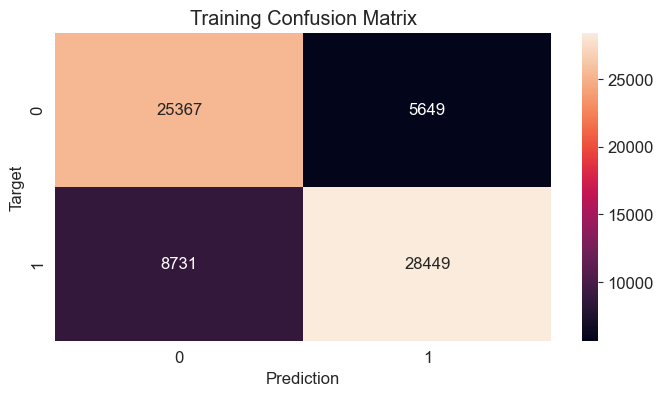

logistic Regression Classification Report for Training Set

              precision    recall  f1-score   support

           0       0.82      0.74      0.78     34098
           1       0.77      0.83      0.80     34098

    accuracy                           0.79     68196
   macro avg       0.79      0.79      0.79     68196
weighted avg       0.79      0.79      0.79     68196



In [91]:
train_preds = LogisticRegression_model.predict(x_train)
cm = confusion_matrix(train_preds,x_train_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Training Confusion Matrix')
plt.show() 

print('logistic Regression Classification Report for Training Set')
print()
print(classification_report(x_train_targets, train_preds))

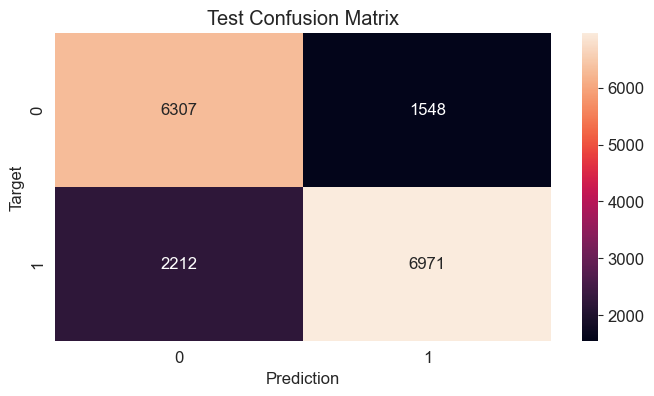

logistic Regression Classification Report for Test Set

              precision    recall  f1-score   support

           0       0.80      0.74      0.77      8519
           1       0.76      0.82      0.79      8519

    accuracy                           0.78     17038
   macro avg       0.78      0.78      0.78     17038
weighted avg       0.78      0.78      0.78     17038



In [92]:
test_preds = LogisticRegression_model.predict(x_test)
cm = confusion_matrix(test_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show() 

print('logistic Regression Classification Report for Test Set')
print()
print(classification_report(x_test_targets, test_preds))

In [93]:
from sklearn.metrics import recall_score
lr_recall = recall_score(x_test_targets, LogisticRegression_model.predict(x_test))

# KNN(K Nearest Neigbhours)


This algorithm works on the idea that when similar data points seem to have similar labels or values. The KNN method uses the complete training dataset as a reference throughout the training phase. It uses a selected distance metric, such as Euclidean distance, to determine the distance between each training example and the input data point before making predictions.
Based on their distances, the algorithm then determines the K closest neighbours of the input data point. When it comes to classification, the algorithm predicts the label for the input data point based on the most prevalent class label among the K neighbours 


In [94]:
from sklearn.neighbors import KNeighborsClassifier

In [95]:
knn=KNeighborsClassifier(n_neighbors=2)

In [96]:
knn.fit(x_train, x_train_targets)

KNeighborsClassifier(n_neighbors=2)

In [97]:
knn.score(x_train, x_train_targets)

0.9919936653176139

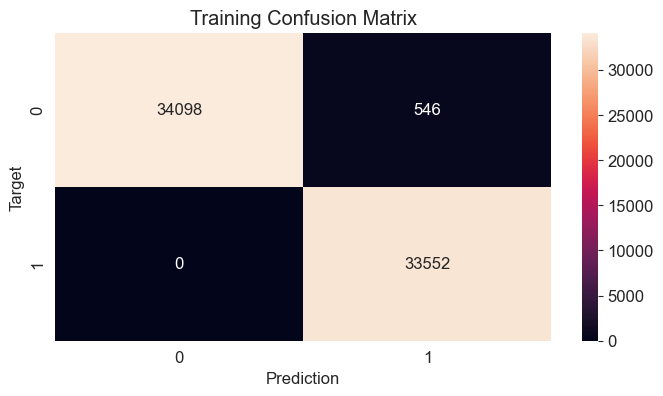

Knn Classification Report for Training Set

              precision    recall  f1-score   support

           0       0.98      1.00      0.99     34098
           1       1.00      0.98      0.99     34098

    accuracy                           0.99     68196
   macro avg       0.99      0.99      0.99     68196
weighted avg       0.99      0.99      0.99     68196



In [98]:
train_preds = knn.predict(x_train)
cm = confusion_matrix(train_preds,x_train_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Training Confusion Matrix')
plt.show() 

print('Knn Classification Report for Training Set')
print()
print(classification_report(x_train_targets, train_preds))

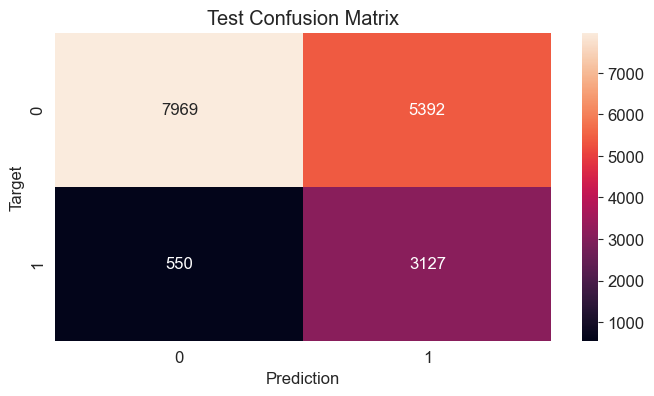

knn Classification Report for Test Set

              precision    recall  f1-score   support

           0       0.60      0.94      0.73      8519
           1       0.85      0.37      0.51      8519

    accuracy                           0.65     17038
   macro avg       0.72      0.65      0.62     17038
weighted avg       0.72      0.65      0.62     17038



In [99]:
test_preds = knn.predict(x_test)
cm = confusion_matrix(test_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show() 

print('knn Classification Report for Test Set')
print()
print(classification_report(x_test_targets, test_preds))

In [100]:
from sklearn.metrics import recall_score
knn_recall = recall_score(x_test_targets, knn.predict(x_test))

# SVM(Support Vector Machine)

SVM identifies hyperplane which divides two best classes .SVM manily rely on statistical methods .Small and complex datasets are ideal for SVM to operate on. Generally speaking, it's best to start with logistic regression and see how it works. If it doesn't provide a good level of accuracy, you may then switch to SVM without a kernel.

In [101]:
from sklearn.svm import SVC

In [102]:
svc_model =  SVC(kernel='linear', random_state = 10)

In [103]:
svc_model .fit(x_train, x_train_targets)

SVC(kernel='linear', random_state=10)

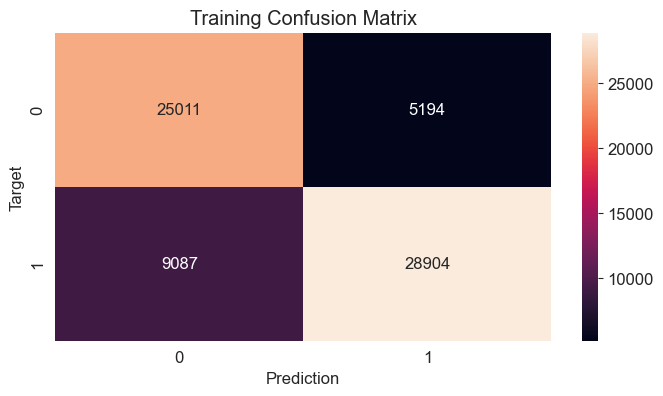

SVC Classification Report for Training Set

              precision    recall  f1-score   support

           0       0.83      0.73      0.78     34098
           1       0.76      0.85      0.80     34098

    accuracy                           0.79     68196
   macro avg       0.79      0.79      0.79     68196
weighted avg       0.79      0.79      0.79     68196



In [104]:
train_preds = svc_model .predict(x_train)
cm = confusion_matrix(train_preds,x_train_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Training Confusion Matrix')
plt.show() 

print('SVC Classification Report for Training Set')
print()
print(classification_report(x_train_targets, train_preds))

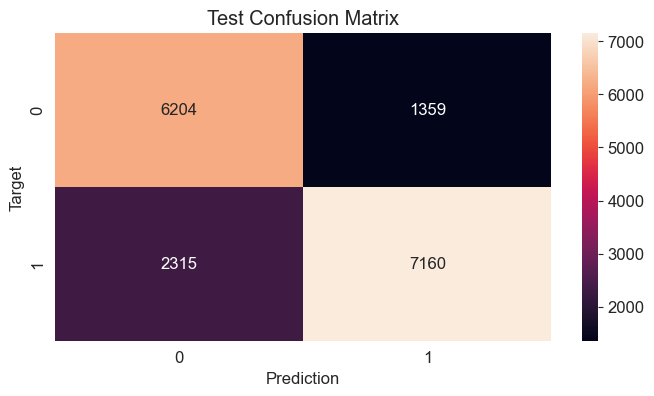

SVC Classification Report for Test Set

              precision    recall  f1-score   support

           0       0.82      0.73      0.77      8519
           1       0.76      0.84      0.80      8519

    accuracy                           0.78     17038
   macro avg       0.79      0.78      0.78     17038
weighted avg       0.79      0.78      0.78     17038



In [105]:
test_preds = svc_model.predict(x_test)
cm = confusion_matrix(test_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show() 

print('SVC Classification Report for Test Set')
print()
print(classification_report(x_test_targets, test_preds))

In [106]:
from sklearn.metrics import recall_score
svc_recall = recall_score(x_test_targets, svc_model.predict(x_test))

# Decision Tree model

Decision tree is a hierarchical tree structure of binary decisions, to train the decision we import decision tree classifier. Here we are dealing with classification problem, so we use decision tree classifier instead of regression. 

# Decision tree workflow 

Randomization is important factor to determine how decision tree work. We need to provide a random state to get same kind of result each time when you run the model, if you don’t want to, default will be zero. It generally recommends to use a random state, if you want to replicate the results or else it will not.

In [107]:
DecisionTree_model = DecisionTreeClassifier(random_state=42)

In [108]:
DecisionTree_model.fit(x_train, x_train_targets)

DecisionTreeClassifier(random_state=42)

In [109]:
DecisionTree_model.score (x_train , x_train_targets)

1.0

In [110]:
DecisionTree_model.score (x_test , x_test_targets)

0.9171851156238995

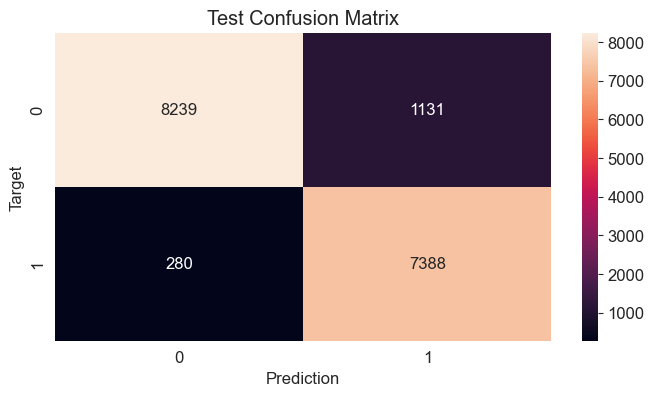

Decision Tree Classification Report for training set


              precision    recall  f1-score   support

           0       0.88      0.97      0.92      8519
           1       0.96      0.87      0.91      8519

    accuracy                           0.92     17038
   macro avg       0.92      0.92      0.92     17038
weighted avg       0.92      0.92      0.92     17038



In [111]:
test_preds = DecisionTree_model.predict(x_test)
cm = confusion_matrix(test_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show() 

print('Decision Tree Classification Report for training set')
print()
print()
print(classification_report(x_test_targets, test_preds))

In [112]:
from sklearn.tree import plot_tree,  export_text

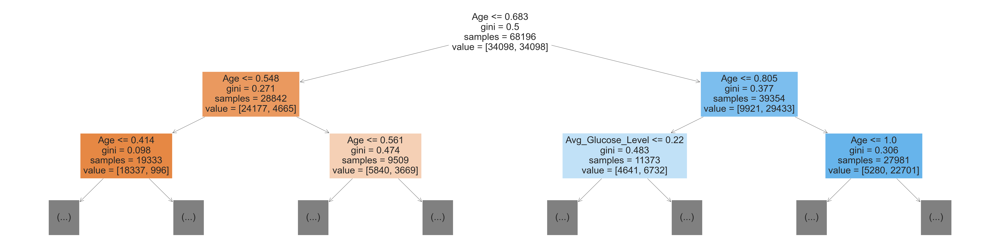

In [113]:
plt.figure (figsize=(80,20))
plot_tree(DecisionTree_model, feature_names=x_train.columns, max_depth=2, filled=True);

In [114]:
DecisionTree_model.tree_.max_depth

35

In [115]:
DecisionTree_model.feature_importances_

array([0.80778348, 0.00898291, 0.01289607, 0.0535988 , 0.04945987,
       0.00603435, 0.00412429, 0.        , 0.00222377, 0.0054112 ,
       0.00498731, 0.        , 0.00876102, 0.00540327, 0.        ,
       0.00495569, 0.00706781, 0.00584572, 0.00815816, 0.00430627])

In [116]:
importance_df = pd.DataFrame({
    'feature' : x_train.columns,
    'importance':DecisionTree_model.feature_importances_
}).sort_values('importance', ascending=False)

In [117]:
importance_df.head(10)

,feature,importance
0,Age,0.807783
3,Avg_Glucose_Level,0.053599
4,BMI,0.049460
2,Heart_Disease,0.012896
1,Hypertension,0.008983
12,Work_Type_Private,0.008761
18,Smoking_Status_never smoked,0.008158
16,Residence_Type_Urban,0.007068
5,Gender_Female,0.006034
17,Smoking_Status_formerly smoked,0.005846


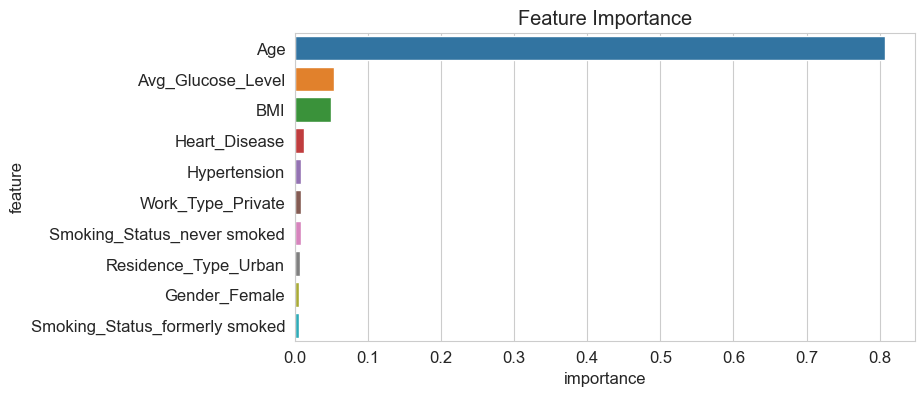

In [118]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance',y='feature');

In [119]:
DecisionTree_model.tree_.max_depth

35

# Hyperparameter Tuning and Overfitting

# Max Depth 

In [120]:
def max_depth_error(md):
    DecisionTree_model = DecisionTreeClassifier(max_depth=md, random_state=42)
    DecisionTree_model.fit(x_train, x_train_targets)
    train_acc = 1 - DecisionTree_model.score(x_train, x_train_targets)
    test_acc = 1 - DecisionTree_model.score(x_test, x_test_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Test Error': test_acc}

In [121]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])

CPU times: total: 7.95 s
Wall time: 8.28 s


In [122]:
errors_df

,Max Depth,Training Error,Test Error
0,1,0.213884,0.215636
1,2,0.213884,0.215636
2,3,0.205393,0.220155
3,4,0.201610,0.212349
4,5,0.189087,0.209649
5,6,0.181770,0.204308
6,7,0.172180,0.196619
7,8,0.162458,0.191865
8,9,0.150845,0.187463
9,10,0.139744,0.180303


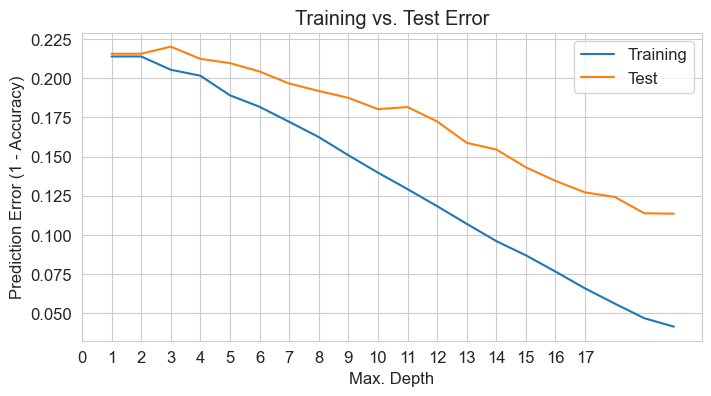

In [123]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Test Error'])
plt.title('Training vs. Test Error')
plt.xticks(range(0,18))
plt.xlabel('Max. Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Test']);

Optimal Max depth value = 5

# Max Leaf Nodes

In [124]:
def Max_leaf_nodes_error(mln):
    DecisionTree_model = DecisionTreeClassifier(max_leaf_nodes=mln, random_state=42)
    DecisionTree_model.fit(x_train, x_train_targets)
    train_acc = 1 - DecisionTree_model.score(x_train, x_train_targets)
    test_acc = 1 - DecisionTree_model.score(x_test, x_test_targets)
    return {'Max leaf nodes': mln, 'Training Error': train_acc, 'Test Error': test_acc}

In [125]:
%%time
errors_df = pd.DataFrame([Max_leaf_nodes_error(mln) for mln in range(2, 40)])

CPU times: total: 10.3 s
Wall time: 11.1 s


In [126]:
errors_df

,Max leaf nodes,Training Error,Test Error
0,2,0.213884,0.215636
1,3,0.213884,0.215636
2,4,0.213884,0.215636
3,5,0.210218,0.211410
4,6,0.208341,0.222561
5,7,0.208341,0.222561
6,8,0.205393,0.220155
7,9,0.202387,0.212466
8,10,0.202387,0.212466
9,11,0.198839,0.209649


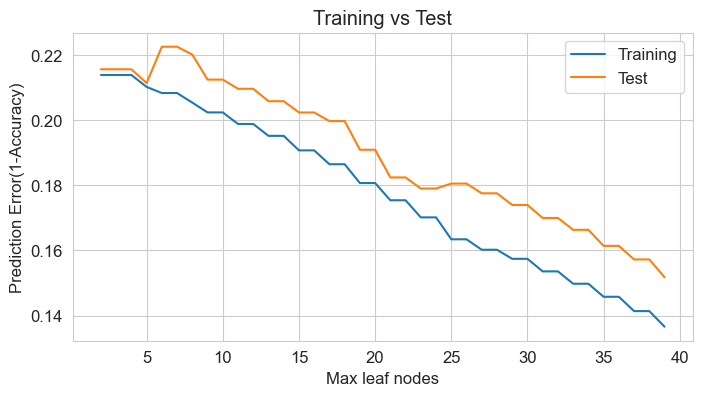

In [127]:
plt.figure()
plt.plot(errors_df['Max leaf nodes'],errors_df['Training Error'])
plt.plot(errors_df['Max leaf nodes'],errors_df['Test Error'])
plt.title('Training vs Test')
plt.xlabel('Max leaf nodes')
plt.ylabel('Prediction Error(1-Accuracy)')
plt.legend(['Training', 'Test']);

In [128]:
def test_params(**params):
    DecisionTree_model = DecisionTreeClassifier(**params).fit(x_train, x_train_targets)
    return DecisionTree_model.score(x_train, x_train_targets),DecisionTree_model.score(x_test, x_test_targets)

# Min Sample Split & Min Sample Leaf

In [129]:
test_params(min_samples_split =5 , min_samples_leaf=3)

(0.9895595049563024, 0.9210588097194506)

In [130]:
test_params(min_samples_split =10 , min_samples_leaf=30)

(0.9599683265880696, 0.9177720389717103)

In [131]:
test_params(min_samples_split =50 , min_samples_leaf=30)

(0.9601002991377794, 0.9177720389717103)

In [132]:
test_params(min_samples_split =100 , min_samples_leaf=50)

(0.9507009208751246, 0.910787651132762)

In [133]:
test_params(min_samples_split =200, min_samples_leaf=100)

(0.9309490292685788, 0.9019838009156004)

In [134]:
DecisionTree_model = DecisionTreeClassifier(
                                           random_state=42,
                                           max_depth = 4,
                                           max_leaf_nodes=5,
                                           min_samples_split=10,
                                           min_samples_leaf=30,
                                           )

In [135]:
DecisionTree_model.fit(x_train, x_train_targets)

DecisionTreeClassifier(max_depth=4, max_leaf_nodes=5, min_samples_leaf=30,
                       min_samples_split=10, random_state=42)

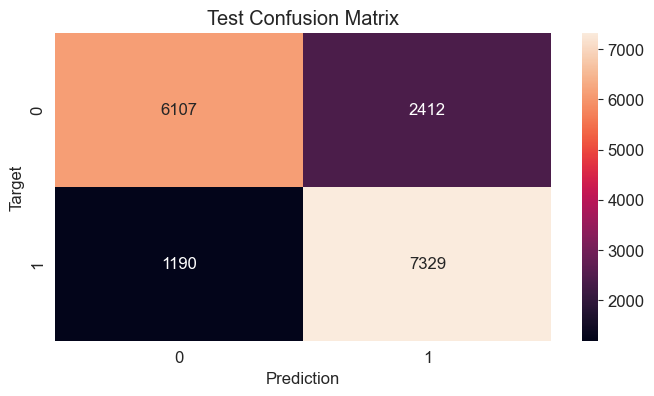

Decision Tree Classification Report for Test set


              precision    recall  f1-score   support

           0       0.84      0.72      0.77      8519
           1       0.75      0.86      0.80      8519

    accuracy                           0.79     17038
   macro avg       0.79      0.79      0.79     17038
weighted avg       0.79      0.79      0.79     17038



In [136]:
test_preds = DecisionTree_model.predict(x_test)
cm = confusion_matrix(x_test_targets, test_preds )
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show()

print('Decision Tree Classification Report for Test set')
print()
print()
print(classification_report(x_test_targets, test_preds ))

In [137]:
from sklearn.metrics import recall_score
dt_recall = recall_score(x_test_targets, DecisionTree_model.predict(x_test))

# Random Forest

Random forests combine several decision trees upon averaging all of them to make better predictions. the general technique of combining several decision trees is called ensemble. It cancels out most of the errors upon averaging them.

Single decision tree can make many errors but combining several decisions trees, many of the errors will cancel out with tuning with several hyperparameters will give better predictions than decision tress.


In [138]:
Randomforest_model = RandomForestClassifier(random_state=42)

In [139]:
Randomforest_model.fit(x_train, x_train_targets) 

RandomForestClassifier(random_state=42)

In [140]:
Randomforest_model.score(x_train, x_train_targets)

1.0

In [141]:
Randomforest_model.score(x_test, x_test_targets)

0.7578354266932739

Training set leads to 100% accuracy, while test set was only 76%, which shows the decision 
tree model is badly overfitted. Overfitting means, you’re getting high accuracy on training set 
and very low accuracy on test set. 
Reducing overfitting is called regularization. We have several techniques for regularization. We 
can pass on arguments like random state, specify criteria which can be Gini or entropy. You 
have max depth parameter to specify the maximum depth of the tree.

# HyperParameters Tuning & Regularization

We have several hyperparameters but we pick some best hyperparameters. And we need to understand what each hyperparameter does. How it fits on overfitting curve and to experiment and find out optimal value for each hyperparameter to increase the model accuracy.

If Training set leads to 100% accuracy, while test set was only 79%, which shows the how badly model is overfitted. Overfitting means, you’re getting high accuracy on training set and very low accuracy on test set.

Reducing overfitting is called regularization. We have several techniques for regularization. We can pass on arguments like random state, specify criteria which can be Gini or entropy. You have max depth parameter to specify the maximum depth of the tree.


In [142]:
def test_params(**params):
    Randomforest_model = RandomForestClassifier(n_jobs=-1, **params).fit(x_train, x_train_targets)
    return Randomforest_model.score(x_train, x_train_targets),Randomforest_model.score(x_test, x_test_targets)

In [143]:
#Random forest Hyperparameters

# N Estimators
# Max Depth & Max Leaf Nodes
# Max Features
# Min Samples Split & Min Samples Leaf
# Min Impurity Decrease
# Bootstrap & Max Samples

# finding out optimal value for each Hyperparamater to reduce overfitting

# n estimators

This argument controls the number of decision trees in the random forest. As you increase the no of estimators, you increase the randomness in the data. This reduces the overfitting for the model. The default value is 100. Small number of estimators will not give the good results for the model. after experimenting with different n estimators’ values, as we keep increasing the n estimators from 100, 200, 300, 400, 500, 600 etc, the accuracy score for the model keeps increasing.

In [144]:
test_params(n_estimators=100)

(1.0, 0.7576593496889307)

In [145]:
test_params(n_estimators=200)

(1.0, 0.7591266580584576)

In [146]:
test_params(n_estimators=300)

(1.0, 0.7591266580584576)

In [147]:
test_params(n_estimators=400)

(1.0, 0.7624134288061979)

In [148]:
test_params(n_estimators=500)

(1.0, 0.761709120788825)

In [149]:
test_params(n_estimators=600)

(1.0, 0.7607113510975466)

In [150]:
test_params(n_estimators=700)

(1.0, 0.7599483507453927)

In [151]:
test_params(n_estimators=800)

(1.0, 0.7596548890714873)

In [152]:
test_params(n_estimators=900)

(1.0, 0.759420119732363)

# Max Depth & Max Leaf Nodes
Normally, by default max depth and max nodes is zero, this makes the training accuracy 100% . to reduce overfitting, we need to specify a number for max depth and max leaf nodes. Plot a graph between training error and validation error to find out optimal values for max depth & max leaf nodes

# Max Depth

In [153]:
def max_depth_error(md):
    Randomforest_model = RandomForestClassifier(max_depth=md, random_state=42)
    Randomforest_model.fit(x_train, x_train_targets)
    train_acc = 1 - Randomforest_model.score(x_train, x_train_targets)
    test_acc = 1 - Randomforest_model.score(x_test, x_test_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Test Error': test_acc}

In [154]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])

CPU times: total: 2min 34s
Wall time: 2min 42s


In [155]:
errors_df

,Max Depth,Training Error,Test Error
0,1,0.221098,0.227844
1,2,0.211699,0.225379
2,3,0.207739,0.217279
3,4,0.203619,0.216223
4,5,0.196111,0.215636
5,6,0.185671,0.199965
6,7,0.174717,0.198615
7,8,0.158558,0.189459
8,9,0.142589,0.186642
9,10,0.131019,0.181418


From above table, we can clearly see, as the training error goes down, accuracy keeps increasing, its memorizes more training examples but for test set, up to max depth of 5, it keeps decreasing, then on here its keep increasing.

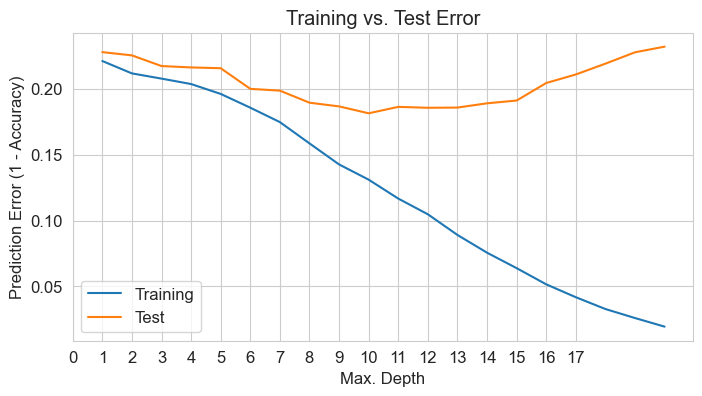

In [156]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Test Error'])
plt.title('Training vs. Test Error')
plt.xticks(range(0,18))
plt.xlabel('Max. Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Test'])

If you increase the complexity of your model, by adding more layers to the decision tree, the training error goes down and test error gets worse. The best way to stop this is where the test error starts increasing. So at max depth of 5 , we can get good test score. This is how you regularize the decision tree.

# Max Leaf Nodes

In [157]:
def Max_leaf_nodes_error(mln):
    Randomforest_model = RandomForestClassifier(max_leaf_nodes=mln, random_state=42)
    Randomforest_model.fit(x_train, x_train_targets)
    train_acc = 1 - Randomforest_model.score(x_train, x_train_targets)
    test_acc = 1 - Randomforest_model.score(x_test, x_test_targets)
    return {'Max leaf nodes': mln, 'Training Error': train_acc, 'Test Error': test_acc}

In [158]:
%%time
errors_df = pd.DataFrame([Max_leaf_nodes_error(mln) for mln in range(2, 40)])

CPU times: total: 3min 8s
Wall time: 3min 15s


In [159]:
errors_df

,Max leaf nodes,Training Error,Test Error
0,2,0.221098,0.227844
1,3,0.216714,0.228020
2,4,0.211625,0.224498
3,5,0.207901,0.220390
4,6,0.207182,0.220272
5,7,0.205980,0.218159
6,8,0.204821,0.217338
7,9,0.204235,0.216692
8,10,0.202886,0.218981
9,11,0.202021,0.219157


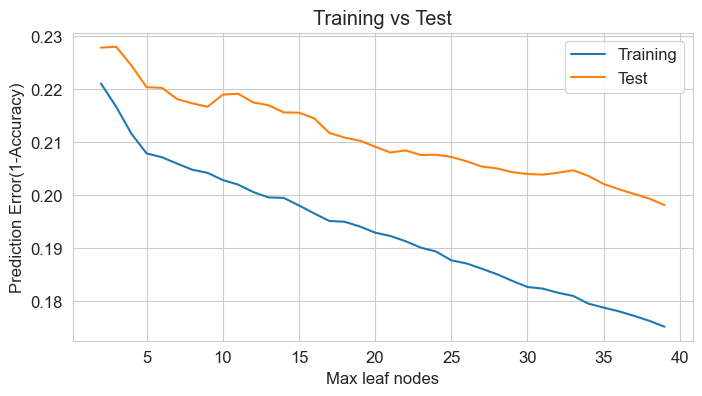

In [160]:
plt.figure()
plt.plot(errors_df['Max leaf nodes'],errors_df['Training Error'])
plt.plot(errors_df['Max leaf nodes'],errors_df['Test Error'])
plt.title('Training vs Test')
plt.xlabel('Max leaf nodes')
plt.ylabel('Prediction Error(1-Accuracy)')
plt.legend(['Training', 'Test']);

# Max Features

Max features pick only certain features randomly from the data set for every split, if not, random forest 
classifier picks same feature multiple times and creates copies of split. this will not create randomness, and 
the model will memorize the same examples again and again leads to over-fitting. So, if we give a value for 
max feature, its picks only fraction of columns from the dataset, which stops picking same columns again 
and again, creates more randomness and we will get good split leads to good results. 
Find out the optimal value for max features 


test_params(max_features='sqrt')

In [161]:
test_params(max_features='auto')

(0.9999853363833656, 0.7593027350628008)

In [162]:
test_params(max_features='log2')

(1.0, 0.756426810658528)

# min sample split & min sample leaf

Generally random forest classifier does certain splits on each side with min samples split and 
min samples leaf. We can give certain value for min samples split and min samples leaf to 
decide. If we give high number of min samples split and min sample leaf, we end up in high 
complexity, same if we give low values, we end up in low complexity. 
Find out optimal value for this parameter to reduce overfitting. 


In [163]:
test_params(min_samples_split =5 , min_samples_leaf=3)

(0.9845152208340665, 0.7736823570841648)

In [164]:
test_params(min_samples_split =10 , min_samples_leaf=5)

(0.9716845562789607, 0.7892945181359314)

In [165]:
test_params(min_samples_split =50 , min_samples_leaf=30)

(0.8955363950964866, 0.8154712994482921)

In [166]:
test_params(min_samples_split =100 , min_samples_leaf=60)

(0.867352923925157, 0.811597605352741)

In [167]:
test_params(min_samples_split =150 , min_samples_leaf=90)

(0.8552994310516746, 0.8091912196267167)

In [168]:
test_params(min_samples_split =200 , min_samples_leaf=120)

(0.8437445011437621, 0.8058457565441953)

# min impurity decrease

It helps to reduce overfitting by maintaining the Gini value as low as possible for each node 
split which gives good results. 


In [169]:
test_params(min_impurity_decrease=10**-2)

(0.7905448999941346, 0.7746801267754432)

In [170]:
test_params(min_impurity_decrease=10**-3)

(0.8009267405712945, 0.7908792111750206)

In [171]:
test_params(min_impurity_decrease=10**-4)

(0.870388292568479, 0.8171733771569433)

In [172]:
test_params(min_impurity_decrease=10**-5)

(0.9621971963164995, 0.7961028289705364)

# bootstrap &  max samples

By default, bootstrap is true which means it takes entire data set to make an optimal split, 
which again leads to overfitting, model is memorizing the examples again & again, instead will 
make it as false, then its takes only certain number of rows for each split and model will 
generalize better and create more randomness which reduce the overfitting. 
We can also control size of bootstrap by giving a value to max samples, this will pick certain 
number of samples from the data set, not entire data.  Like 40000(0.4) rows or 20000(0.2) 
rows. This will make more randomness.

In [173]:
test_params(bootstrap=True)

(1.0, 0.7573658880150252)

In [174]:
test_params(bootstrap=False)

(1.0, 0.7485620377978636)

# max samples¶

In [175]:
test_params(bootstrap=True, max_samples=0.2)

(0.9684878878526599, 0.7870055170794694)

In [176]:
test_params(bootstrap=True, max_samples=0.3)

(0.981362543257669, 0.7829557459795751)

In [177]:
test_params(bootstrap=True, max_samples=0.4)

(0.9887236788081413, 0.7676957389364949)

In [178]:
test_params(bootstrap=True, max_samples=0.5)

(0.9935626722974955, 0.7679892006104003)

In [179]:
test_params(bootstrap=True, max_samples=0.6)

(0.9976978121883981, 0.7654067378800329)

# All hyperparameters together

In [181]:
Randomforest_model = RandomForestClassifier( n_jobs=-1,
                                           random_state=42,
                                           max_depth = 12,
                                           max_leaf_nodes=5,
                                           min_samples_split=100,
                                           min_samples_leaf=60,
                                           )

In [182]:
Randomforest_model.fit(x_train, x_train_targets) 

RandomForestClassifier(max_depth=12, max_leaf_nodes=5, min_samples_leaf=60,
                       min_samples_split=100, n_jobs=-1, random_state=42)

In [183]:
Randomforest_model.score(x_train, x_train_targets)

0.7920992433573817

In [184]:
Randomforest_model.score(x_test, x_test_targets)

0.7795515905622725

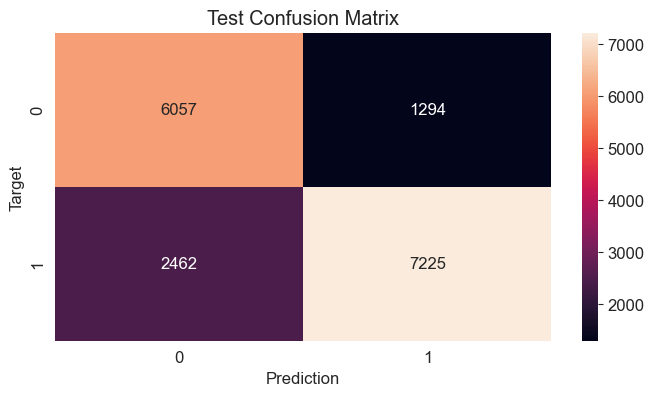

Random Forest Classification Report for Test set


              precision    recall  f1-score   support

           0       0.82      0.71      0.76      8519
           1       0.75      0.85      0.79      8519

    accuracy                           0.78     17038
   macro avg       0.78      0.78      0.78     17038
weighted avg       0.78      0.78      0.78     17038



In [185]:
RF_preds = Randomforest_model.predict(x_test)
cm = confusion_matrix(RF_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show()


print('Random Forest Classification Report for Test set')
print()
print()
print(classification_report(x_test_targets, RF_preds))

In [186]:
from sklearn.metrics import recall_score
rf_recall = recall_score(x_test_targets, Randomforest_model.predict(x_test))

# Gradient Boosting Classifier

A machine learning ensemble technique called gradient boosting successively combines the predictions of several weak learners, usually decision trees. By refining the model's weights based on the mistakes of earlier iterations, it seeks to enhance overall predictive performance by progressively lowering prediction errors and raising the model's accuracy.

In [187]:
from sklearn.ensemble import GradientBoostingClassifier

In [188]:
GB_model = GradientBoostingClassifier(random_state=42)

In [189]:
GB_model.fit(x_train, x_train_targets)

GradientBoostingClassifier(random_state=42)

In [190]:
GB_model.score(x_train, x_train_targets)

0.8587453809607601

In [191]:
GB_model.score(x_test, x_test_targets)

0.847223852564855

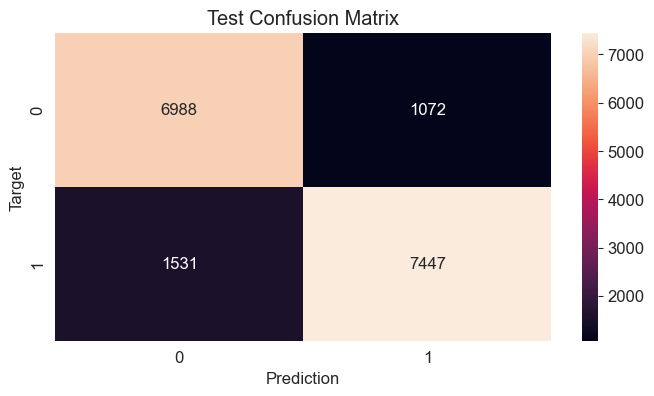

GB Classification Report for Test set


              precision    recall  f1-score   support

           0       0.87      0.82      0.84      8519
           1       0.83      0.87      0.85      8519

    accuracy                           0.85     17038
   macro avg       0.85      0.85      0.85     17038
weighted avg       0.85      0.85      0.85     17038



In [192]:
GB_preds = GB_model.predict(x_test)
cm = confusion_matrix(GB_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show()


print('GB Classification Report for Test set')
print()
print()
print(classification_report(x_test_targets, GB_preds))

# HyperParameter Tuning to Reduce Overfitting

In [193]:
def test_params(**params):
    GB_model = GradientBoostingClassifier(**params).fit(x_train, x_train_targets)
    return GB_model.score(x_train, x_train_targets),GB_model.score(x_test, x_test_targets)

# N Estimators

In [194]:
test_params(n_estimators=20)

(0.8204293506950554, 0.813886606409203)

In [195]:
test_params(n_estimators=50)

(0.834799694996774, 0.8258598427045428)

In [196]:
test_params(n_estimators=70)

(0.8442723913426008, 0.8341941542434558)

In [197]:
test_params(n_estimators=100)

(0.8587453809607601, 0.847223852564855)

In [198]:
test_params(n_estimators=150)

(0.8847293096369289, 0.8753961732597723)

In [199]:
test_params(n_estimators=200)

(0.9104492932136782, 0.9022185702547247)

In [200]:
test_params(n_estimators=250)

(0.9441316206229105, 0.9353797394060336)

In [201]:
test_params(n_estimators=300)

(0.9553639509648659, 0.9519896701490785)

In [202]:
test_params(n_estimators=350)

(0.960305589770661, 0.9613217513792699)

In [203]:
test_params(n_estimators=400)

(0.9652325649598217, 0.9677192158704073)

# Max Depth

In [204]:
def max_depth_error(md):
    GB_model = GradientBoostingClassifier(max_depth=md, random_state=42)
    GB_model.fit(x_train, x_train_targets)
    train_acc = 1 - GB_model.score(x_train, x_train_targets)
    test_acc = 1 - GB_model.score(x_test, x_test_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Test Error': test_acc}

In [205]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])
errors_df

CPU times: total: 16min 11s
Wall time: 16min 21s


,Max Depth,Training Error,Test Error
0,1,0.199513,0.207360
1,2,0.179233,0.186466
2,3,0.141255,0.152776
3,4,0.099375,0.115037
4,5,0.061763,0.082991
5,6,0.035134,0.061803
6,7,0.021072,0.046367
7,8,0.009663,0.036624
8,9,0.007258,0.032985
9,10,0.004370,0.031518


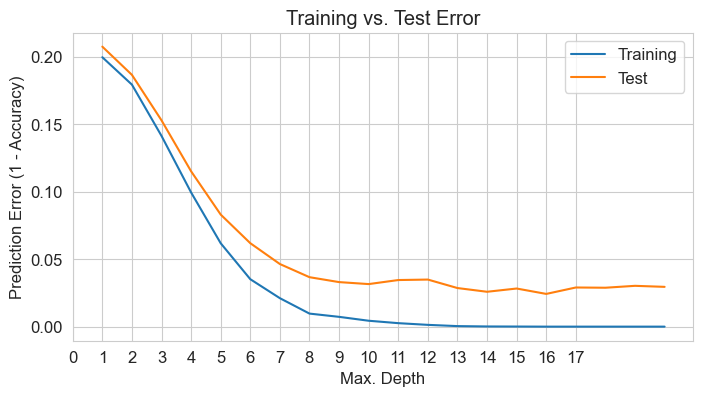

In [206]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Test Error'])
plt.title('Training vs. Test Error')
plt.xticks(range(0,18))
plt.xlabel('Max. Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Test'])

# Learning rate

In [207]:
test_params(learning_rate = 0.2)

(0.9206698340078597, 0.9131353445240051)

In [208]:
test_params(learning_rate = 0.2)

(0.9206698340078597, 0.9131353445240051)

In [209]:
test_params(learning_rate = 0.3)

(0.9572115666608012, 0.9541025942011974)

In [210]:
test_params(learning_rate = 0.4)

(0.9696903044166814, 0.9714755252963962)

In [211]:
test_params(learning_rate = 0.5)

(0.9762449410522611, 0.9771099894353797)

In [212]:
test_params(learning_rate = 0.6)

(0.9779605841984867, 0.975818758070196)

In [213]:
test_params(learning_rate = 0.7)

(0.9778286116487771, 0.9786946824744688)

In [214]:
test_params(learning_rate = 0.8)

(0.9790017009795295, 0.9783425284657824)

In [215]:
test_params(learning_rate = 0.9)

(0.9793976186286586, 0.9752905270571663)

In [216]:
test_params(learning_rate = 0.10)

(0.8587453809607601, 0.847223852564855)

In [217]:
GB_model = GradientBoostingClassifier(learning_rate = 0.9,
                                         random_state=42,
                                           max_depth = 5,
                                      n_estimators=50,)


In [218]:
GB_model.fit(x_train, x_train_targets)

GradientBoostingClassifier(learning_rate=0.9, max_depth=5, n_estimators=50,
                           random_state=42)

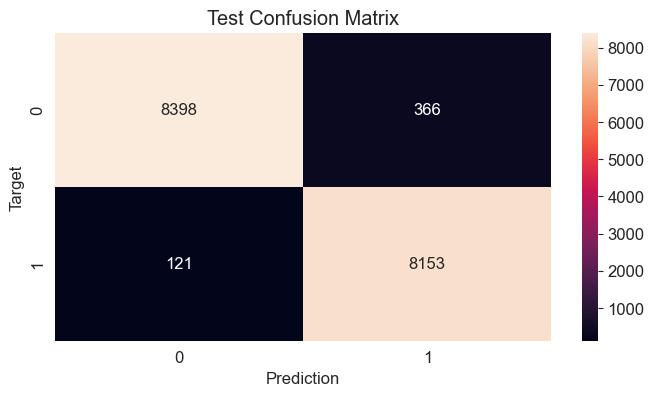

GB Classification Report for Test set


              precision    recall  f1-score   support

           0       0.96      0.99      0.97      8519
           1       0.99      0.96      0.97      8519

    accuracy                           0.97     17038
   macro avg       0.97      0.97      0.97     17038
weighted avg       0.97      0.97      0.97     17038



In [219]:
GB_preds = GB_model.predict(x_test)
cm = confusion_matrix(GB_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show()


print('GB Classification Report for Test set')
print()
print()
print(classification_report(x_test_targets, GB_preds))

In [220]:
from sklearn.metrics import recall_score
gb_recall = recall_score(x_test_targets, GB_model.predict(x_test))

# Artificial Neural Network Classifier


Artificial Neural Networks
Artificial neural networks model was inspired by human brain neural structure, which as interconnected nodes called neurons formed into layers. data flows through these nodes and networks adjusts the weights during training to learn from data to recognizes patterns to make better predictions as output.
It has three layers in ANN, the input layer, the hidden layer (one or more), and output layer.

In [223]:
from tensorflow.keras.models import Sequential

In [224]:
from tensorflow.keras.layers import Dense
import tensorflow as tf
import keras as keras
from keras.optimizers import Adam
from keras.layers import Dropout
from keras import regularizers


In [225]:
ann_model = Sequential()

# layers

ann_model.add(Dense(units = 20, kernel_initializer = 'uniform', activation = 'relu', input_dim = 20))
ann_model.add(Dense(units = 20, kernel_initializer = 'uniform', activation = 'relu'))
ann_model.add(Dense(units = 1, kernel_initializer = 'uniform', activation = 'sigmoid'))

# Compiling the ANN
opt = Adam(learning_rate=0.00009)
ann_model.compile(optimizer = opt, loss = 'binary_crossentropy', metrics = ['accuracy'])

# Train the ANN
history = ann_model.fit(x_train, x_train_targets, batch_size = 10, epochs = 10, validation_split= 0.2)

Epoch 1/10
5456/5456 [==============================] - 10s 2ms/step - loss: 0.5557 - accuracy: 0.6982 - val_loss: 0.7085 - val_accuracy: 0.6273
Epoch 2/10
5456/5456 [==============================] - 9s 2ms/step - loss: 0.4616 - accuracy: 0.7695 - val_loss: 0.5918 - val_accuracy: 0.7635
Epoch 3/10
5456/5456 [==============================] - 9s 2ms/step - loss: 0.4395 - accuracy: 0.7844 - val_loss: 0.5655 - val_accuracy: 0.7815
Epoch 4/10
5456/5456 [==============================] - 9s 2ms/step - loss: 0.4349 - accuracy: 0.7857 - val_loss: 0.5822 - val_accuracy: 0.7675
Epoch 5/10
5456/5456 [==============================] - 8s 2ms/step - loss: 0.4330 - accuracy: 0.7870 - val_loss: 0.5982 - val_accuracy: 0.7544
Epoch 6/10
5456/5456 [==============================] - 9s 2ms/step - loss: 0.4314 - accuracy: 0.7876 - val_loss: 0.6158 - val_accuracy: 0.7418
Epoch 7/10
5456/5456 [==============================] - 9s 2ms/step - loss: 0.4300 - accuracy: 0.7884 - val_loss: 0.5768 - val_accuracy

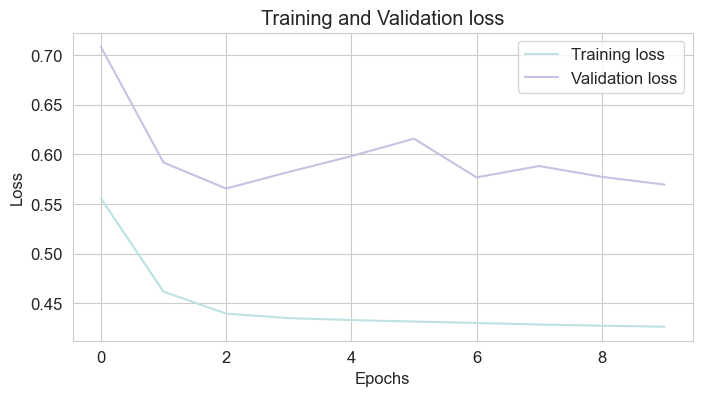

In [226]:
history_df = pd.DataFrame(history.history)

plt.plot(history_df.loc[:, ['loss']], "#BDE2E2", label='Training loss')
plt.plot(history_df.loc[:, ['val_loss']],"#C2C4E2", label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(loc="best")

plt.show()

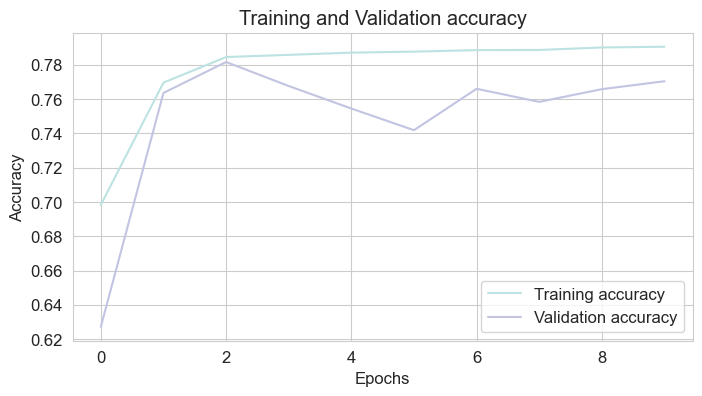

In [227]:
history_df = pd.DataFrame(history.history)

plt.plot(history_df.loc[:, ['accuracy']], "#BDE2E2", label='Training accuracy')
plt.plot(history_df.loc[:, ['val_accuracy']], "#C2C4E2", label='Validation accuracy')

plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

533/533 [==============================] - 1s 1ms/step


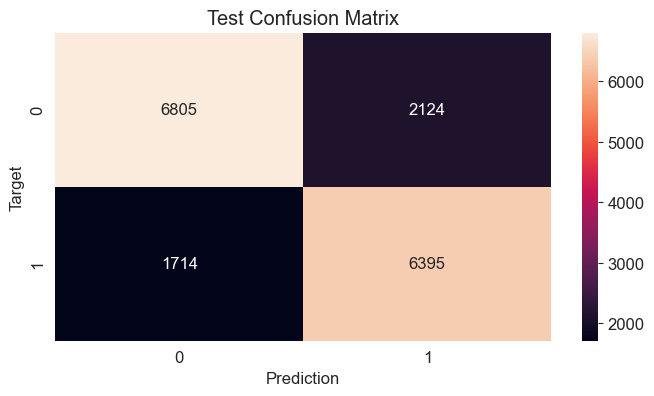

ANN Report for Test set


              precision    recall  f1-score   support

           0       0.76      0.80      0.78      8519
           1       0.79      0.75      0.77      8519

    accuracy                           0.77     17038
   macro avg       0.78      0.77      0.77     17038
weighted avg       0.78      0.77      0.77     17038



In [236]:
test_preds = ann_model.predict(x_test)
test_preds = (test_preds > 0.5 )
cm = confusion_matrix(test_preds, x_test_targets)
plt.figure()
sns.heatmap(cm , annot=True, fmt='g')
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Test Confusion Matrix')
plt.show()


print('ANN Report for Test set')
print()
print()
print(classification_report(x_test_targets, test_preds))

In [231]:
from sklearn.metrics import recall_score


In [238]:
ann_recall = recall_score(x_test_targets, test_preds)

# Model Performance Evaluation

Choosing the right evaluation metrics for model performance (Accuracy, Precision, Recall, F1-Score) is crucial for predicting the heart stroke especially for Class 1-Stroke due to high false negative cases. 
 
We cannot depend solely on accuracy metric, as they can be deceptive in the case of unbalanced datasets such as our own. wherein one class is overrepresented. We have more non-stroke (Class 0) samples than stroke samples (Class 1) in our Dataset. As a result, the model's overall performance is significantly misleading in terms of how well it can identify stroke samples. If you are interested in predicting stroke for patients, the accuracy is not very informative. 

When there are many false positives, precision is a useful metric.

Recall is an effective metric when false negative costs are high. Recall is an important metric in medical cases because, although raising a false alarm is not important, identifying the true positive cases is. Our project involves forecasting heart attacks based on highly skewed data, with a high percentage of non-stroke samples. When the cost of false negatives is high, recall is a very useful metric for our dataset because it can capture all true positives, preventing the stroke population from being mistakenly released into the non-stroke population.

So, we calculate our Model Performance using Recall Evaluation Metrics for all the Classifier and to determine which is the highest Recall Rate for the Classifiers while using for real world Applications.


# Model Comparasion- Recall Score

In [240]:
models = pd.DataFrame({
    'Model' : ['Logistic Regression', 'KNN', 'Decision Tree Classifier', 'Random Forest Classifier','SVC',
             'Gradient Boosting Classifier','Artificial Neural Networks'],
    'Recall_Score' : [lr_recall,knn_recall,svc_recall,dt_recall,rf_recall,gb_recall,ann_recall]
})


models.sort_values(by = 'Recall_Score', ascending = False)

,Model,Recall_Score
5,Gradient Boosting Classifier,0.957037
3,Random Forest Classifier,0.860312
4,SVC,0.848104
2,Decision Tree Classifier,0.840474
0,Logistic Regression,0.818289
6,Artificial Neural Networks,0.750675
1,KNN,0.367062


In [241]:
px.bar(data_frame = models, x = 'Recall_Score', y = 'Model', color = 'Recall_Score', template = 'plotly_dark', title = 'Models Comparison')

# Conclusion

This research was done using a range of machine learning models and deep learning model to predict the heart stroke. A detailed EDA was done to see the insights and correlation between variables. Different Resampling techniques were employed such as Oversampling and SMOTE to tackle the problem of class imbalance in our dataset to increase the model performance. We have tuned the models with different hyperparameters and found the optimal hyperparameters for each model to reduce the overfitting and thereby increase the model performance.

Recall was the best metric chosen which suites our dataset to Calculate the model performance score Because cost of false negatives is high and has ability to capture all the actual positives to avoid mistakenly releasing the stroke population into non stroke population.

From the experiments, we found SMOTE oversampling technique was the most effective than other resampling methods. Ands from the experiments, Gradient Boosting classifier was performed better other all other models with SMOTE oversampling With the Recall score of 95%. 
